<a href="https://colab.research.google.com/github/L-Shyamal/EN2550-Assignment_1/blob/main/Assigment_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# M.A.L .Shyamal

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [8]:
import numpy as np
import cv2 as cv
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt


## Question 1

Original Image


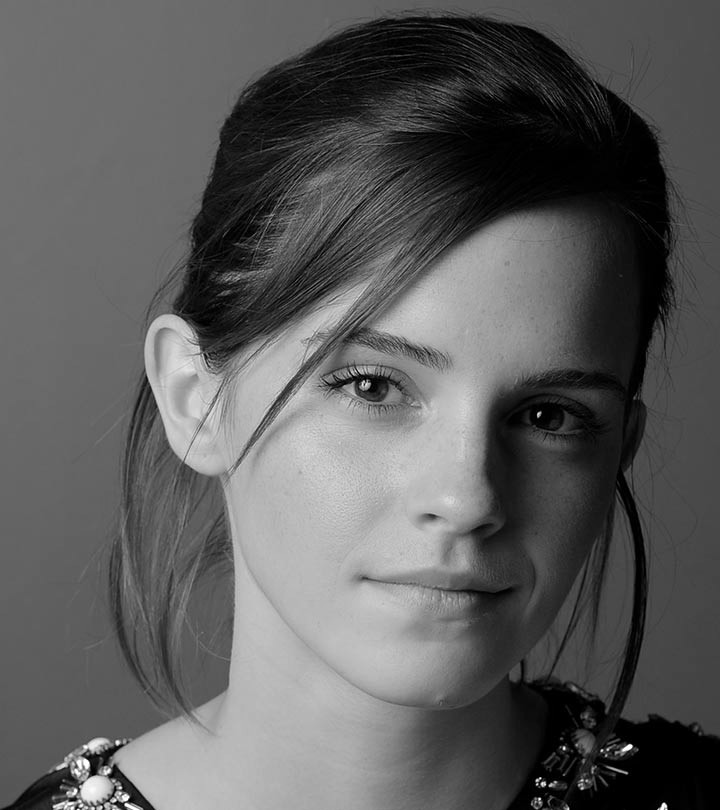

Transformed Image


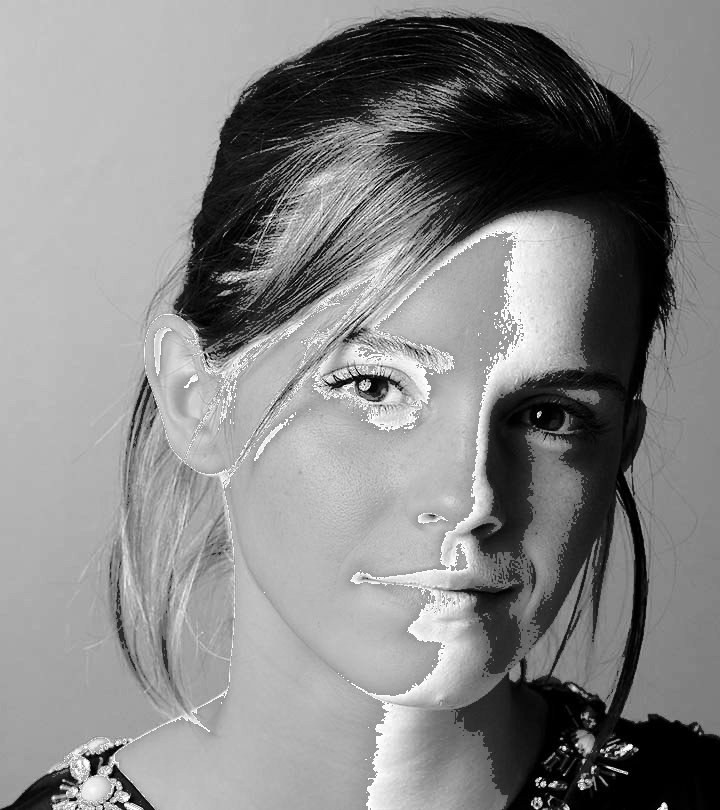

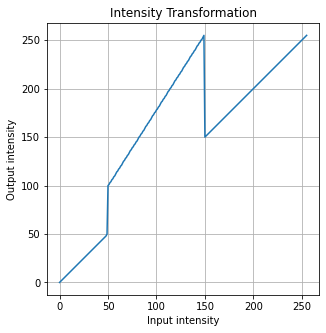

In [3]:
img = cv.imread("/content/drive/MyDrive/Assignment1/emma_gray.jpg")

t1 = np.linspace(0,50,50)
t2 = np.linspace(50,100,0)
t3 = np.linspace(100,255,100)
t4 = np.linspace(255,150,0)
t5 = np.linspace(150,255,106)

t = np.concatenate((t1,t2,t3,t4,t5),axis=0).astype(np.uint8)
fig,ax = plt.subplots(figsize=(5,5))
ax.set_title("Intensity Transformation")
ax.set_ylabel("Output intensity")
ax.set_xlabel("Input intensity")
ax.grid()
ax.plot(t)

ax.set_aspect("equal")
assert len(t) ==256
g = cv.LUT(img,t)

print("Original Image")
cv2_imshow(img)
print("Transformed Image")
cv2_imshow(g)


## Question 2

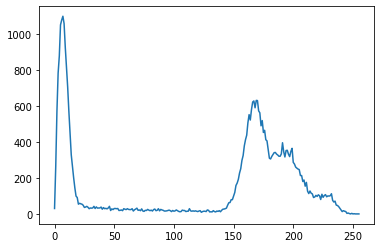

In [5]:
brain = cv.imread("/content/drive/MyDrive/Assignment1/brain_proton_density_slice.png")


hist_brain = cv.calcHist([brain],[0],None,[256],[0, 256])
plt.plot(hist_brain)




Original Image


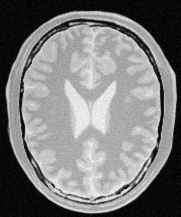

Gray matter Image


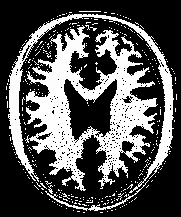

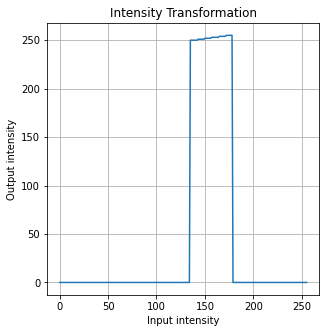

In [40]:
# Gray matter
t1 = np.linspace(0,0,135)
t2 = np.linspace(0,250,0)
t3 = np.linspace(250,256,45)
t4 = np.linspace(256,0,0)
t5 = np.linspace(0,0,76)

t = np.concatenate((t1,t2,t3,t4,t5),axis=0).astype(np.uint8)

assert len(t) ==256
g = cv.LUT(brain,t)

fig,ax = plt.subplots(figsize=(5,5))
ax.set_title("Intensity Transformation")
ax.set_ylabel("Output intensity")
ax.set_xlabel("Input intensity")
ax.grid()
ax.plot(t)
ax.set_aspect("equal")




print("Original Image")
cv2_imshow(brain)
print("Gray matter Image")
cv2_imshow(g)

Original Image


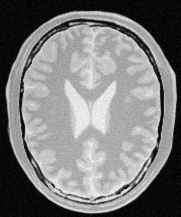

White Matter Image


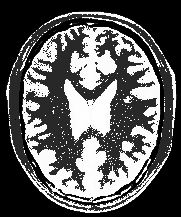

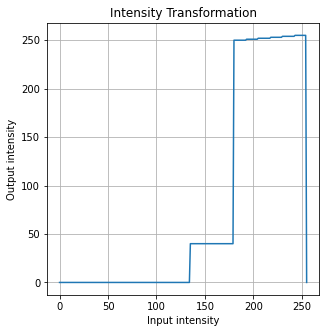

In [44]:
# White matter
t1 = np.linspace(0,0,135)
t2 = np.linspace(0,40,0)
t3 = np.linspace(40,40,45)
t4 = np.linspace(40,250,0)
t5 = np.linspace(250,256,76)

t = np.concatenate((t1,t2,t3,t4,t5),axis=0).astype(np.uint8)

assert len(t) ==256
g = cv.LUT(brain,t)


fig,ax = plt.subplots(figsize=(5,5))
ax.set_title("Intensity Transformation")
ax.set_ylabel("Output intensity")
ax.set_xlabel("Input intensity")
ax.grid()
ax.plot(t)
ax.set_aspect("equal")




print("Original Image")
cv2_imshow(brain)
print("White Matter Image")
cv2_imshow(g)

## Question 3

Original Image


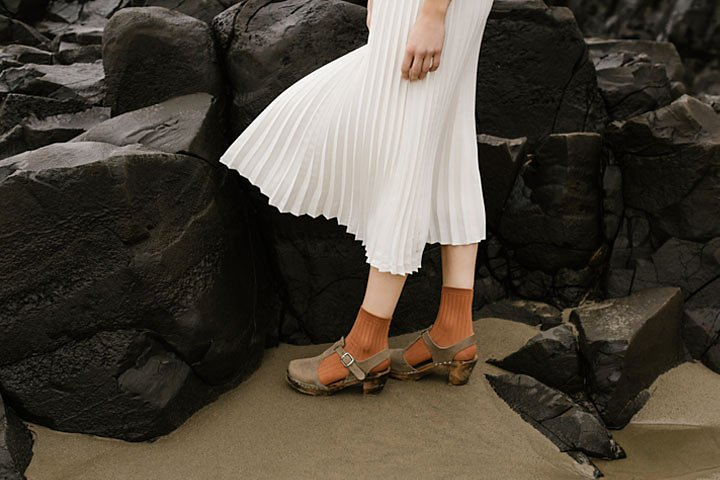

Output Image


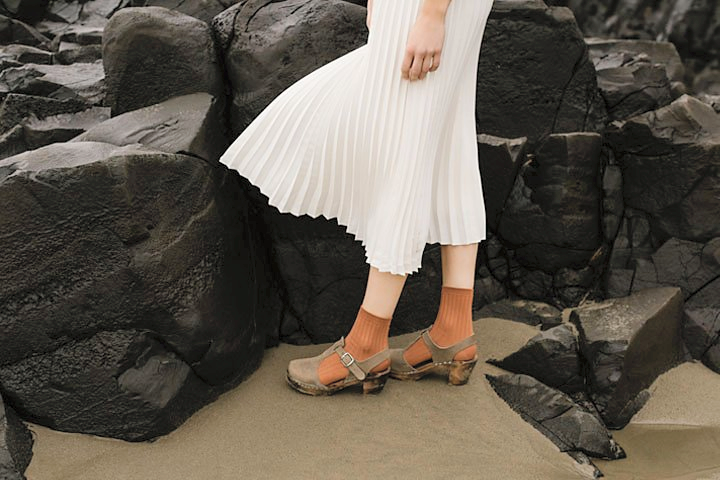

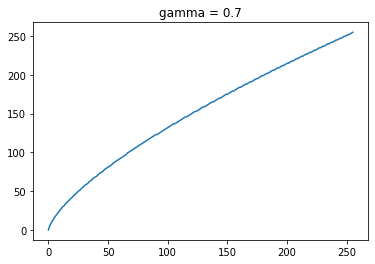

In [5]:
# Q 3
original_image = cv.imread("/content/drive/MyDrive/Assignment1/highlights_and_shadows.jpg")
assert original_image is not None

Lab = cv.cvtColor(original_image, cv.COLOR_BGR2LAB)
gamma = 0.7
L,a,b = cv.split(Lab)
t = np.array([(p/255)**gamma*255 for p in range (0,256)]).astype(np.uint8)
fig, ax = plt.subplots()
ax.plot(t)
ax.set_title("gamma = "+str(gamma))


g = cv.LUT(L ,t)
trans = cv.merge([g,a,b])
output_image = cv.cvtColor(trans,cv.COLOR_LAB2BGR)

print("Original Image")
cv2_imshow(original_image)
print("Output Image")
cv2_imshow(output_image)

Text(0.5, 1.0, 'Histogram of the Corrected image')

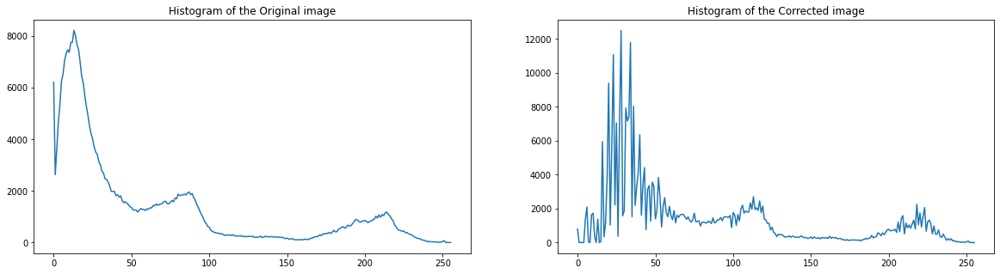

In [6]:
hist_f = cv.calcHist([original_image],[0],None,[256],[0,256])
hist_g = cv.calcHist([output_image],[0],None,[256],[0,256])

fig, ax  = plt.subplots(1,2,figsize = (20,5))
ax[0].plot(hist_f)
ax[0].set_title("Histogram of the Original image")
ax[1].plot(hist_g)
ax[1].set_title("Histogram of the Corrected image")

## Question 4

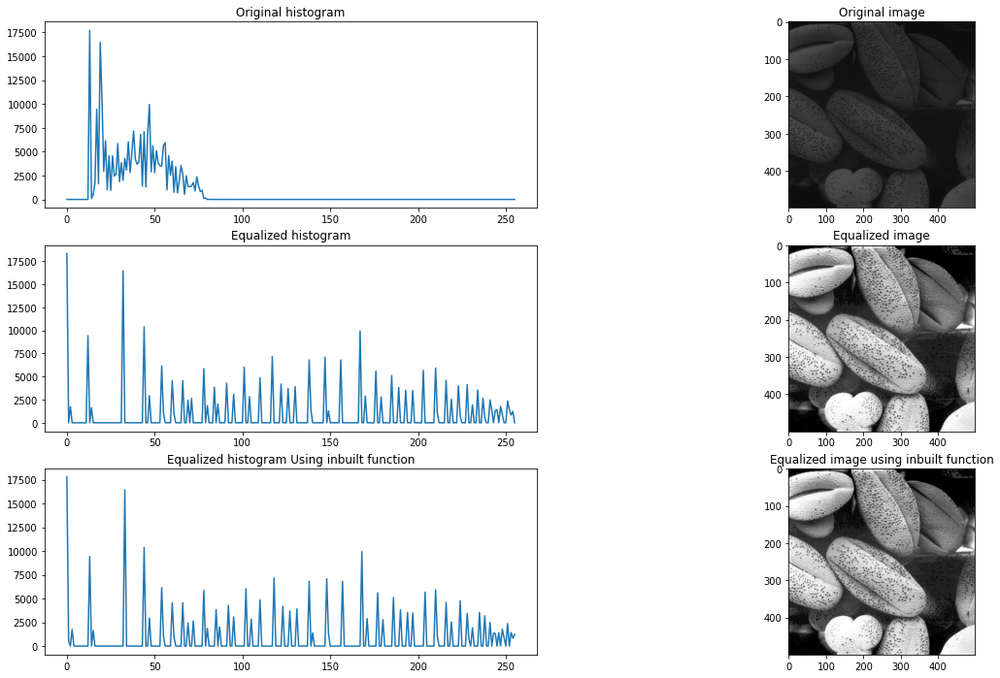

In [7]:
def histEqulize(img):
    historig, bins = np.histogram(img.flatten(), 256, [0, 255])
    cdf = historig.cumsum()
    cdf_m = np.ma.masked_equal(cdf, 0)
    cdf_m = (cdf_m - cdf_m.min()) * 255 / (cdf_m.max() - cdf_m.min())
    cdf = np.ma.filled(cdf_m, 0)
    imgEq = cdf[img.astype('uint8')]
    histEq, bins2 = np.histogram(imgEq.flatten(), 256, [0, 256])
    return imgEq, historig, histEq

shells = cv.imread("/content/drive/MyDrive/Assignment1/shells.png",cv.IMREAD_GRAYSCALE)
g, hist_f, hist_g = histEqulize(shells)

k= cv.equalizeHist(shells)
k_hist = cv.calcHist([k],[0],None,[256],[0, 256])

fig, ax  = plt.subplots(3,2,figsize = (20,12))
ax[0][0].plot(hist_f)
ax[0][0].set_title("Original histogram")
ax[0][1].imshow(shells,cmap="gray",vmin=0,vmax=255)
ax[0][1].set_title("Original image")

ax[1][0].plot(hist_g)
ax[1][0].set_title("Equalized histogram")
ax[1][1].imshow(g,cmap="gray",vmin=0,vmax=255)
ax[1][1].set_title("Equalized image")

ax[2][0].plot(k_hist)
ax[2][0].set_title("Equalized histogram Using inbuilt function")
ax[2][1].imshow(k,cmap="gray",vmin=0,vmax=255)
ax[2][1].set_title("Equalized image using inbuilt function")
plt.show()

## Question 5

In [14]:
# Q 5
def zoom_nearest_neigbor(im,scale):
  
  rows = int(im.shape[0]*scale)
  coloms = int(im.shape[1]*scale)
  zoomed = np.zeros((rows,coloms,3),dtype=im.dtype)
  
  for i in range(0,rows):
    for j in range(0,coloms):
      for k in range(0,3):

        I,J = int(i/scale),int(j/scale)
        I_lim, J_lim= int(not(I==im.shape[0]-1)) , int(not(J==im.shape[1]-1))
        zoomed[i,j,k]=im[int(i/scale +0.5*I_lim ),int(j/scale +0.5*J_lim),k]
                
  return(zoomed)



def zoom_interpolation(im,scale):
  rows = int(im.shape[0]*scale)
  coloms = int(im.shape[1]*scale)
  zoomed = np.zeros((rows,coloms,3),dtype=im.dtype)

  pad_im = cv.copyMakeBorder(im, 0, 1, 0, 1, cv.BORDER_REPLICATE)   #The bottom-row and right-column at the very edge of the original is replicated to the extra border.
  
  for i in range(0,rows):
    for j in range(0,coloms):
      I,J = int(i/scale),int(j/scale)
      for k in range(0,3):
        inter_i_left = (i/scale -I) * pad_im[I+1,J,k] + (I+1 - i/scale) * pad_im[I,J,k]
        inter_i_right = (i/scale -I) * pad_im[I+1,J+1,k] + (I+1 - i/scale) * pad_im[I,J+1,k]
        pixel_value = inter_i_right * (j/scale-J) + inter_i_left * (J+1 - j/scale) 
        zoomed[i,j,k]=pixel_value

  return(zoomed)

In [17]:
def SSD(image1,image2):

  ssd = np.sqrt((np.sum((image1 - image2)**2))/(int(np.shape(image1)[0])*int(np.shape(image1)[1])*np.shape(image1)[2]))
  return(ssd)

In [15]:
imsmall_1 = cv.imread("/content/drive/MyDrive/Assignment1/a1q5images/im01small.png")
assert imsmall_1 is not None
imsmall_2 = cv.imread("/content/drive/MyDrive/Assignment1/a1q5images/im02small.png")
assert imsmall_2 is not None
imsmall_3 = cv.imread("/content/drive/MyDrive/Assignment1/a1q5images/im03small.png")
assert imsmall_3 is not None

In [16]:
# uploading given zoomed images
given_1 = cv.imread("/content/drive/MyDrive/Assignment1/a1q5images/im01.png")
assert given_1 is not None
given_2 = cv.imread("/content/drive/MyDrive/Assignment1/a1q5images/im02.png")
assert given_2 is not None
given_3 = cv.imread("/content/drive/MyDrive/Assignment1/a1q5images/im03.png")
assert given_3 is not None

### Using Nearest-Neighbor method

Original Image 1


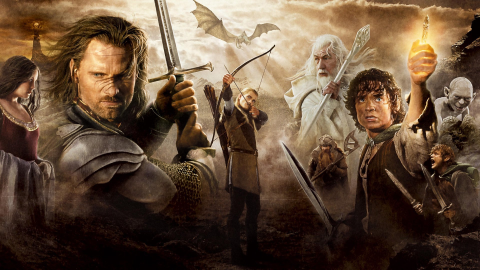

Zoomed By a scale factor = 4


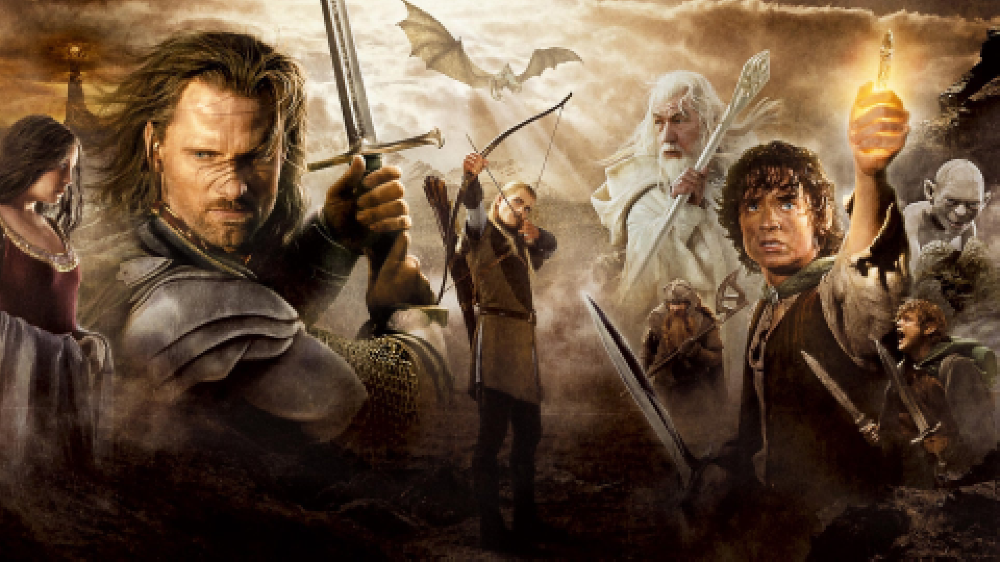

Original Image 2


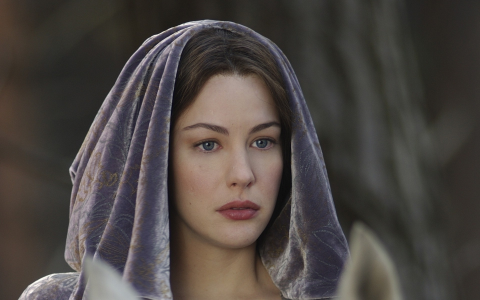

Zoomed By a scale factor = 4


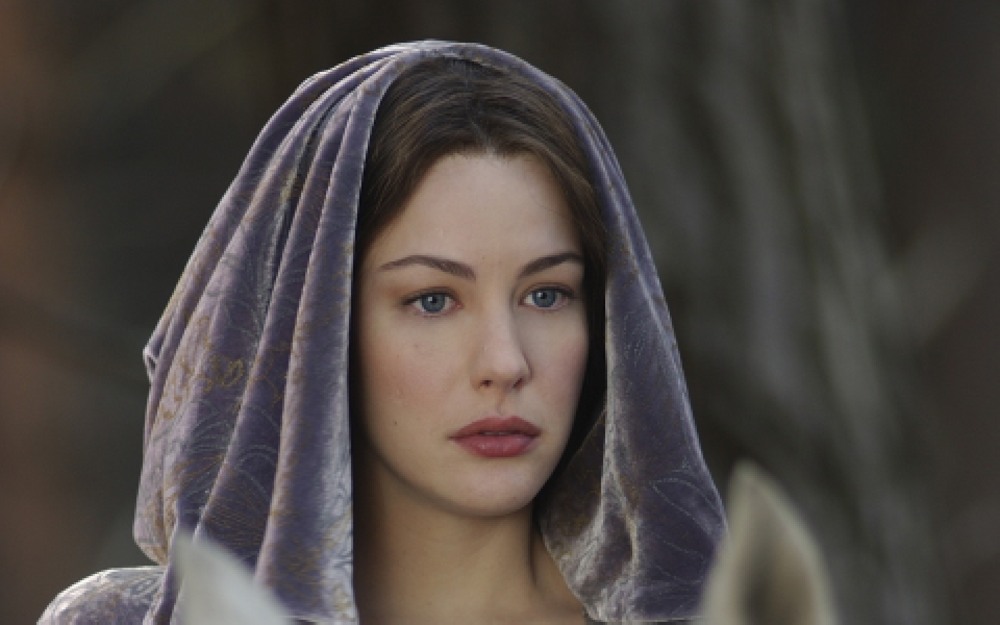

Original Image 3


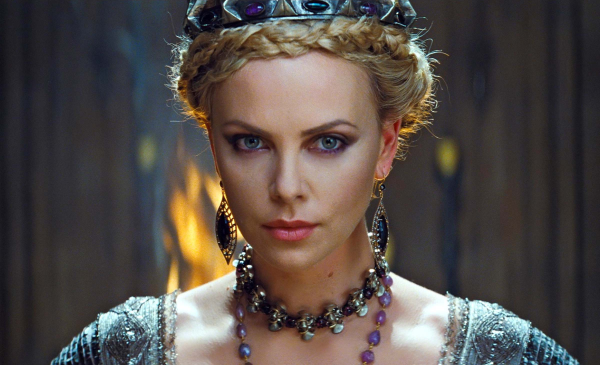

Zoomed By a scale factor = 4


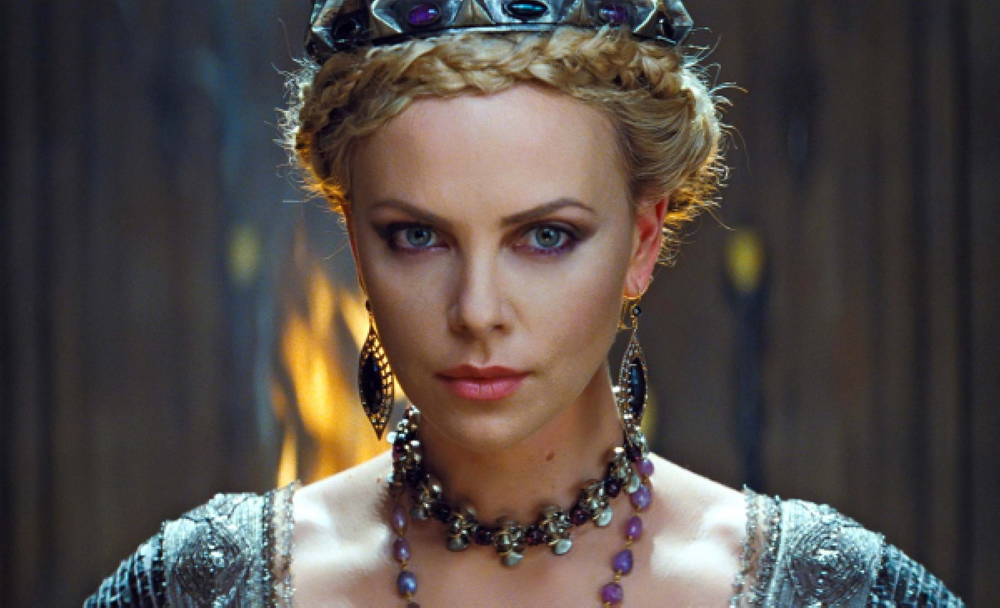

In [18]:
scal = 4

zoomed_im1_near = zoom_nearest_neigbor(imsmall_1,scal)
zoomed_im2_near = zoom_nearest_neigbor(imsmall_2,scal)
zoomed_im3_near = zoom_nearest_neigbor(imsmall_3,scal)

print("Original Image 1")
cv2_imshow(imsmall_1)
print("Zoomed By a scale factor = "+str(scal))
cv2_imshow(zoomed_im1_near)
print("Original Image 2")
cv2_imshow(imsmall_2)
print("Zoomed By a scale factor = "+str(scal))
cv2_imshow(zoomed_im2_near)
print("Original Image 3")
cv2_imshow(imsmall_3)
print("Zoomed By a scale factor = "+str(scal))
cv2_imshow(zoomed_im3_near)


SSD of given zoomed images with nearest neigbhour zoomed images

In [ ]:
d = np.

In [19]:
ssd_1n = SSD(zoomed_im1_near, given_1)
print("SSD of image 1 = "+str(ssd_1n))
ssd_2n = SSD(zoomed_im2_near, given_2)
print("SSD of image 2 = "+str(ssd_2n))
#ssd_3n = SSD(zoomed_im3_near, given_3)
#print("SSD of image 3 = "+str(ssd_3n))

SSD of image 1 = 6.653208904108439
SSD of image 2 = 4.372935690234414


### Using Bilinear Interpolation Method

Original Image 1


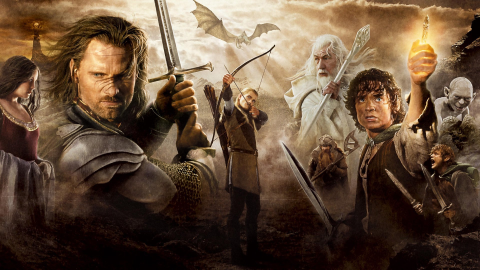

Zoomed By a scale factor = 4


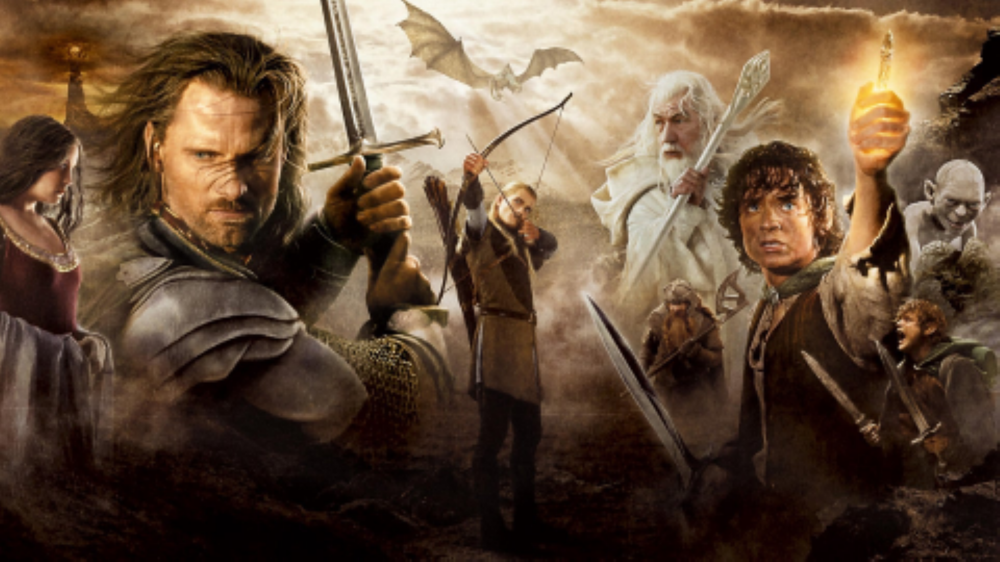

Original Image 2


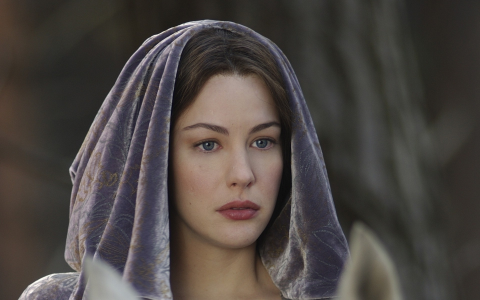

Zoomed By a scale factor = 4


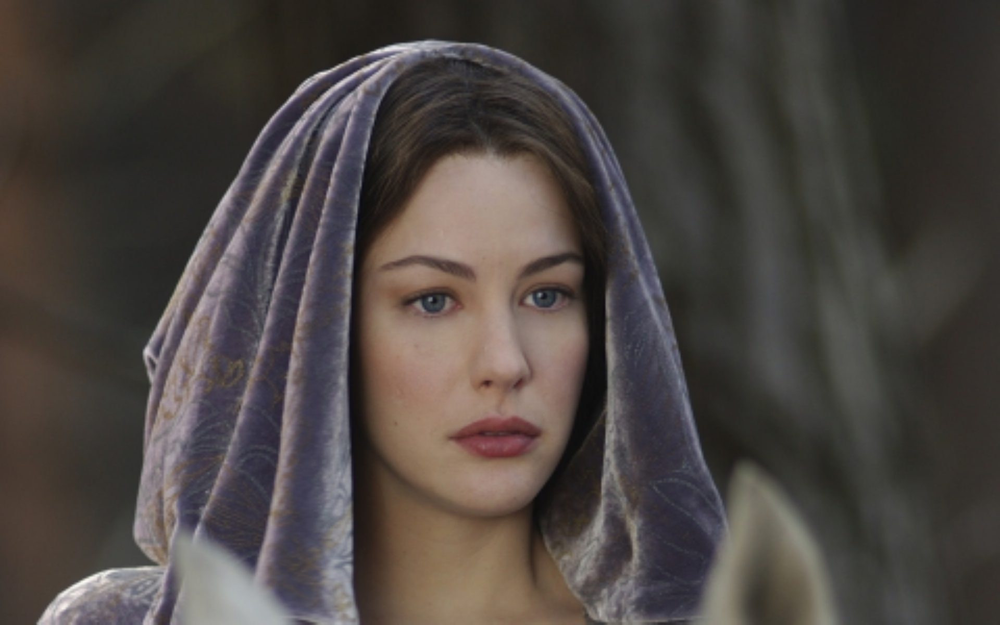

Original Image 3


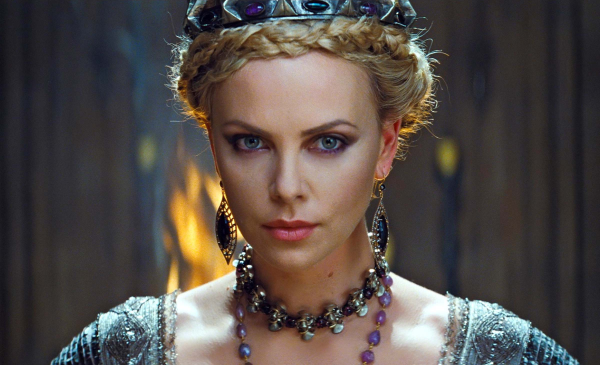

Zoomed By a scale factor = 4


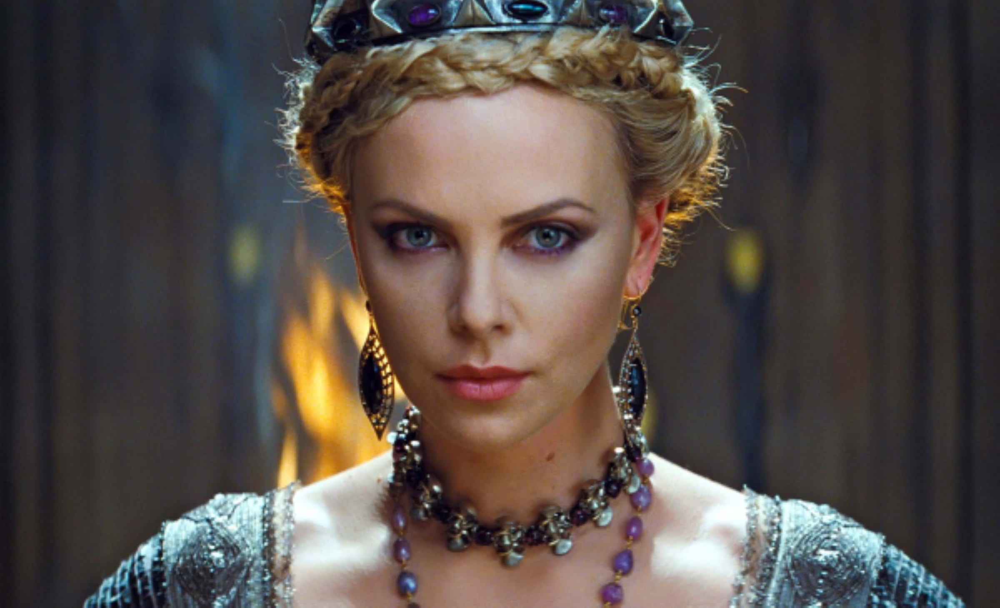

In [20]:
scal = 4
zoomed_im1_inter = zoom_interpolation(imsmall_1,scal)
zoomed_im2_inter = zoom_interpolation(imsmall_2,scal)
zoomed_im3_inter = zoom_interpolation(imsmall_3,scal)

print("Original Image 1")
cv2_imshow(imsmall_1)
print("Zoomed By a scale factor = "+str(scal))
cv2_imshow(zoomed_im1_inter)
print("Original Image 2")
cv2_imshow(imsmall_2)
print("Zoomed By a scale factor = "+str(scal))
cv2_imshow(zoomed_im2_inter)
print("Original Image 3")
cv2_imshow(imsmall_3)
print("Zoomed By a scale factor = "+str(scal))
cv2_imshow(zoomed_im3_inter)

Given Zoomed Image1


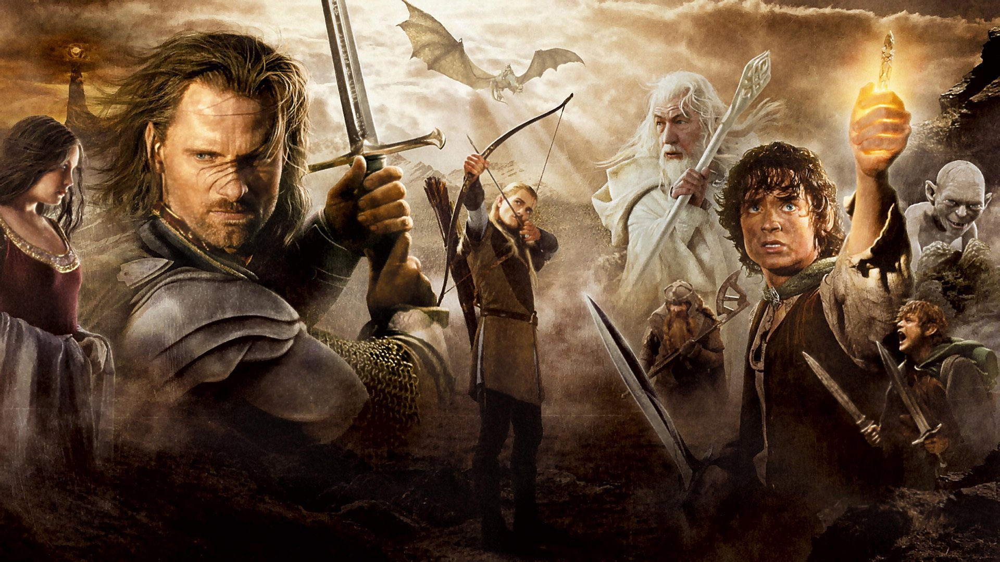

Given Zoomed Image2


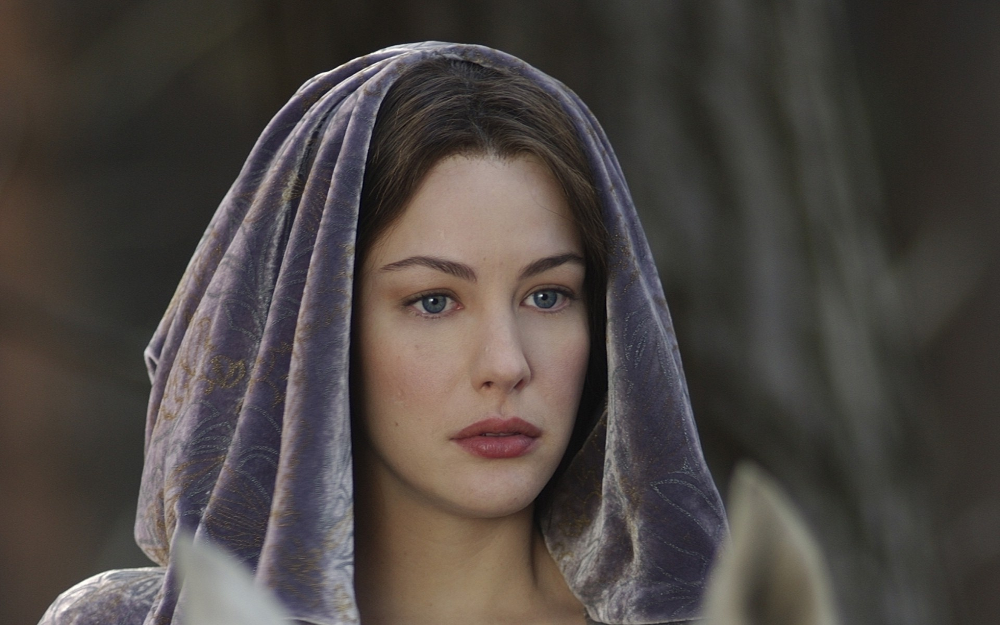

Given Zoomed Image3


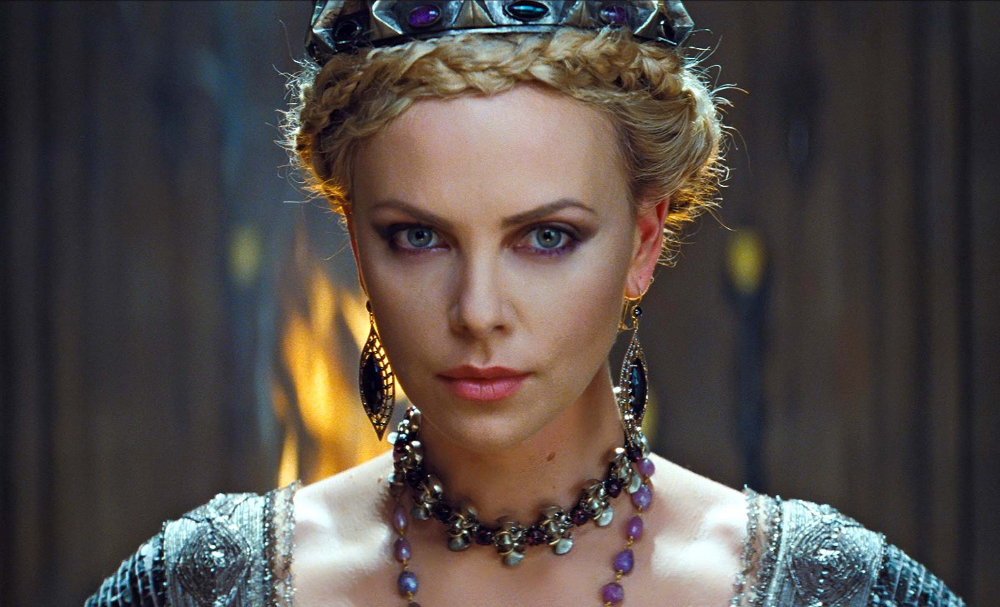

In [ ]:
#printing the given images
print("Given Zoomed Image1")
cv2_imshow(given_1)
print("Given Zoomed Image2")
cv2_imshow(given_2)
print("Given Zoomed Image3")
cv2_imshow(given_3)

SSD of given zoomed images with bilinear-interpolated images

In [21]:
ssd_1i = SSD(zoomed_im1_inter, given_1)
print("SSD of image 1 = "+str(ssd_1i))
ssd_2i = SSD(zoomed_im2_inter, given_2)
print("SSD of image 2 = "+str(ssd_2i))
#ssd_3i = SSD(zoomed_im3_inter, given_3)
#print("SSD of image 3 = "+str(ssd_3i))

SSD of image 1 = 6.265543326720544
SSD of image 2 = 4.026385056147806


## Question 6

In [9]:
# Q 6
albert = cv.imread("/content/drive/MyDrive/Assignment1/einstein.png",cv.IMREAD_GRAYSCALE).astype(np.float32)
assert albert is not None

## a)

Text(0.5, 1.0, 'Gradient Magnitude')

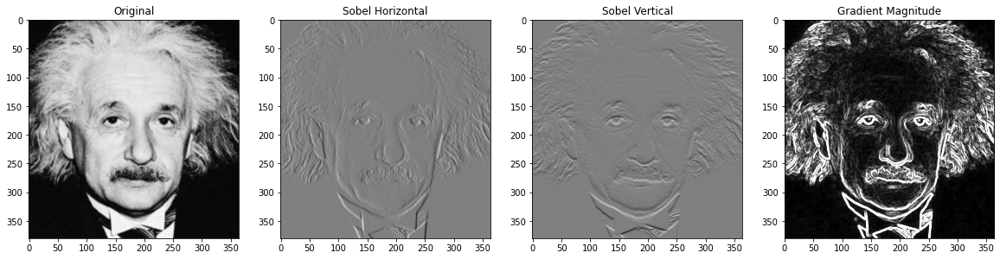

In [10]:
sobel_horizontal = np.array([[-1,-2,-1], [0,0,0], [1,2,1]], dtype=float)
sobel_vertical = sobel_horizontal.transpose()

f_x = cv.filter2D(albert,-1,sobel_vertical)
f_y = cv.filter2D(albert,-1,sobel_horizontal)
grad_im = np.sqrt(f_y**2 + f_x**2)

fig,axes =plt.subplots(1 ,4 ,figsize = (20,20) )

axes[0].imshow(albert,  cmap=  'gray', vmin = 0, vmax = 255) 
axes[0].set_title('Original')

axes[1].imshow(f_x,  cmap=  'gray', vmin = -1020 , vmax = 1020 )
axes[1].set_title('Sobel Horizontal')

axes[2].imshow(f_y , cmap=  'gray' , vmin = -1020 , vmax = 1020)
axes[2].set_title('Sobel Vertical')

axes[3].imshow(grad_im , cmap=  'gray', vmin = 0, vmax = 255)
axes[3].set_title('Gradient Magnitude')


## b)

In [12]:
def mysobel_operator(image,kernal):
  rows = image.shape[0]
  cols = image.shape[1] 
  h = kernal.shape[0]//2
  d = kernal.shape[1]//2                                                                     # define the padsize for padding
  new_im = cv.copyMakeBorder(image, h, h, d, d, cv.BORDER_CONSTANT, value = 0)  # padding the image with "zeros" with size d
  result = np.zeros((rows,cols),dtype=image.dtype)
  for i in range(h ,rows + h):
    for j in range( d, cols + d):
      result[i-h , j-d] = np.sum( np.multiply( kernal, new_im[ i-h :i+h+1 , j-d:j+d+1]  ))
  return(result)

Text(0.5, 1.0, 'Gradient Magnitude')

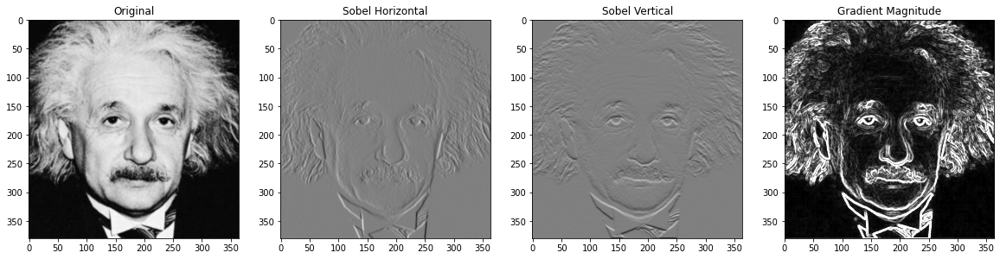

In [13]:
sobel_horizontal = np.array([[-1,-2,-1], [0,0,0], [1,2,1]], dtype=float)
sobel_vertical = sobel_horizontal.transpose()

f_x_my = mysobel_operator(albert,sobel_vertical)
f_y_my = mysobel_operator(albert,sobel_horizontal)
grad_im_my = np.sqrt(f_y_my**2 + f_x_my**2)

fig,axes =plt.subplots(1 ,4 ,figsize = (20,20) )

axes[0].imshow(albert,  cmap=  'gray', vmin = 0, vmax = 255) 
axes[0].set_title('Original')

axes[1].imshow(f_x_my,  cmap=  'gray', vmin = -1020 , vmax = 1020 )
axes[1].set_title('Sobel Horizontal')

axes[2].imshow(f_y_my , cmap=  'gray' , vmin = -1020 , vmax = 1020)
axes[2].set_title('Sobel Vertical')

axes[3].imshow(grad_im_my , cmap=  'gray', vmin = 0, vmax = 255)
axes[3].set_title('Gradient Magnitude')

## c)

Using the commutative property of convolution

Text(0.5, 1.0, 'Gradient Magnitude')

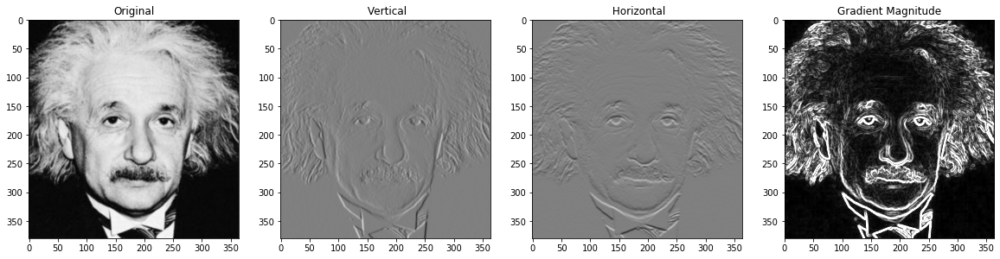

In [ ]:
gaussian_1D = np.array([[1],[2],[1]], dtype=float)
X_derivitive = np.array([[-1,0,1]], dtype=float)
dx =cv.filter2D(albert,-1, X_derivitive)
sobel_x = cv.filter2D(dx,-1,gaussian_1D) 

gaussian_1D_h = np.array([[1,2,1]], dtype=float)
Y_derivitive = np.array([[-1],[0],[1]], dtype=float)
dy =cv.filter2D(albert,-1, Y_derivitive)
sobel_y = cv.filter2D(dy,-1,gaussian_1D_h)

grad_conv = np.sqrt(sobel_x**2 + sobel_y**2)

fig,axes =plt.subplots(1 ,4 ,figsize = (20,20) )

axes[0].imshow(albert,  cmap=  'gray', vmin = 0, vmax = 255) 
axes[0].set_title('Original')

axes[1].imshow(sobel_x, cmap=  'gray' , vmin = -1020 , vmax = 1020 )
axes[1].set_title(' Vertical')

axes[2].imshow(sobel_y,cmap=  'gray' , vmin = -1020 , vmax = 1020  )
axes[2].set_title(' Horizontal')

axes[3].imshow(grad_conv , cmap=  'gray', vmin = 0, vmax = 255)
axes[3].set_title('Gradient Magnitude')

## Question 7

Text(0.5, 1.0, 'Background')

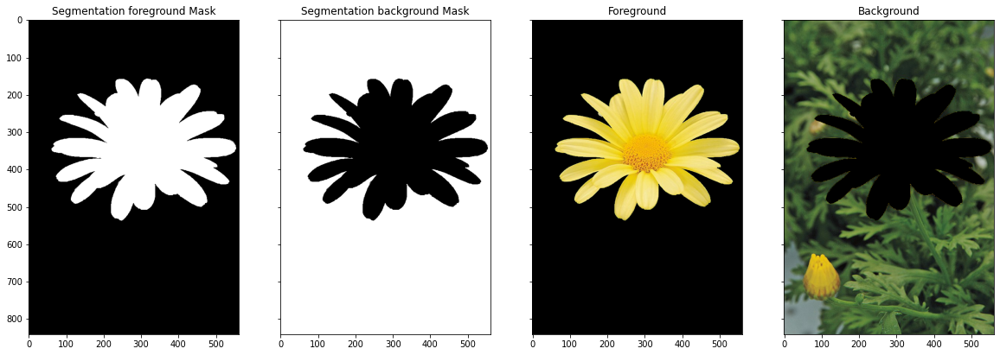

In [5]:
daisy = cv.imread("/content/drive/MyDrive/Assignment1/daisy.jpg")
assert daisy is not None

daisyRGB = cv.cvtColor(daisy,cv.COLOR_BGR2RGB)
mask = np.zeros(daisy.shape[:2], np.uint8)
fgModel = np.zeros((1,65), np.float64)
bgModel = np.zeros((1,65), np.float64)

rect = (50,150,520,400)

cv.grabCut(daisy, mask, rect, bgModel, fgModel, 5,cv.GC_INIT_WITH_RECT)
mask2 = np.where((mask==2) | (mask==0), 0,1).astype('uint8')
mask3 = np.where((mask==1) | (mask==3), 0,1).astype('uint8')

imgcut = daisy * mask2[:,:,np.newaxis]
imgback = daisy * mask3[:,:,np.newaxis]

imgcutRGB = cv.cvtColor(imgcut,cv.COLOR_BGR2RGB)
imgbackRGB = cv.cvtColor(imgback,cv.COLOR_BGR2RGB)

imgbackBlur = cv.GaussianBlur(imgback,(39,39),0)
imgenhanced = cv.add(imgcut ,imgbackBlur)
imgenhancedRGB = cv.cvtColor(imgenhanced,cv.COLOR_BGR2RGB)

fig,axes = plt.subplots(1,4,sharex='all',sharey='all',figsize=(20,20))

axes[0].imshow(mask2, cmap="gray")
axes[0].set_title("Segmentation foreground Mask")

axes[1].imshow(mask3, cmap="gray")
axes[1].set_title("Segmentation background Mask")

axes[2].imshow(imgcutRGB)
axes[2].set_title("Foreground")

axes[3].imshow(imgbackRGB)
axes[3].set_title("Background")

Text(0.5, 1.0, 'Enhanched Image')

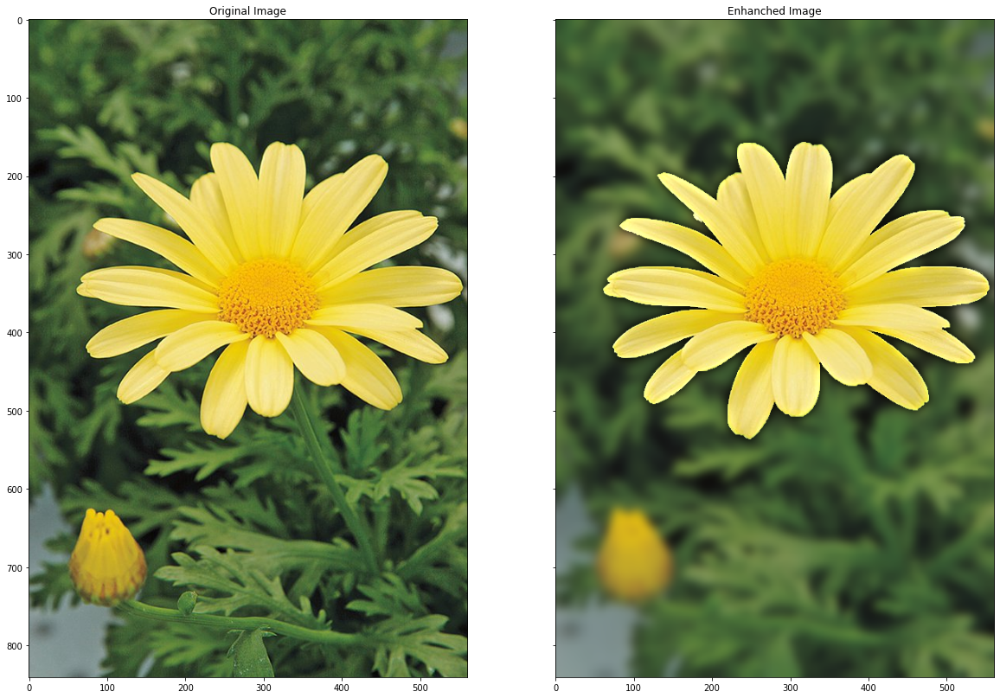

In [6]:
fig,axes = plt.subplots(1,2,sharex='all',sharey='all',figsize=(20,20))

axes[0].imshow(daisyRGB)
axes[0].set_title("Original Image")

axes[1].imshow(imgenhancedRGB)
axes[1].set_title("Enhanched Image")

In [ ]:
#### converting to html
!jupyter nbconvert --to html /content/Assigment_1.ipynb

[NbConvertApp] Converting notebook /content/Assigment_1.ipynb to html
[NbConvertApp] Writing 30733933 bytes to /content/Assigment_1.html


# ⚓
# 💓
